## **Enzyme Kinetics** : 
#### _Accurate numerical solution_ - compared to the **Michaelis-Menten** model approximation and to the alternative **Morrison** model.

#### Two Coupled Reactions: `E + S <-> ES`, and  `ES -> E + P` , using real-life kinetic parameters.  
#### Scenario with _small amount of Enzyme_, relative to the initial Substrate concentration.

#### Unlike in experiment `enzyme_1_a`, we'll use data from a reaction that **VIOLATES the customary Michaelis-Menten assumption** that the rate constants satisfy `k1_reverse >> k2_forward`

### THE REACTION:  
the enzyme `Aminopeptidase` with the substrate `Leu-Ala-DED`,  
and the initial concentration values choosen below, all satisfy the customary Michaelis-Menten assumptions that  `[E] << [S]`    BUT the reaction rate constants DON'T satisfy `k1_reverse >> k2_forward`

For this reaction: k1_forward = 160 , k1_reverse = 0.089 , k2_forward = 0.58 

Source of kinetic parameters:  *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

### TAGS :  "uniform compartment", "chemistry", "numerical", "enzymes"

In [1]:
LAST_REVISED = "Nov. 17, 2024"
LIFE123_VERSION = "1.0.0.rc.0"      # Library version this experiment is based on

In [2]:
#import set_path                    # Using MyBinder?  Uncomment this before running the next cell!

In [3]:
#import sys
#sys.path.append("C:/some_path/my_env_or_install")   # CHANGE to the folder containing your venv or libraries installation!
# NOTE: If any of the imports below can't find a module, uncomment the lines above, or try:  import set_path   

import ipynbname
import pandas as pd

from life123 import check_version, ChemData, UniformCompartment, ReactionEnz, PlotlyHelper

In [4]:
check_version(LIFE123_VERSION)

OK


In [5]:
# Initialize logging (for the system state)
csv_log_file = ipynbname.name() + "_system_log.csv"   # Use the notebook base filename 
                                                      # IN CASE OF PROBLEMS, set manually to any desired name

# 1. Accurate numerical solution

In [6]:
chem_data = ChemData(names=["P", "ES"])

In [7]:
# Our Enzyme
chem_data.add_chemical(name="Aminopeptidase", label="E") 

# Our Substrate
chem_data.add_chemical(name="Leu-Ala-DED", label="S");

In [8]:
chem_data.all_chemicals()

,name,label
0,P,P
1,ES,ES
2,Aminopeptidase,E
3,Leu-Ala-DED,S


### Specify the Kinetic Parameters

Source: *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

### Notice that the reaction rate constants below DON'T satisfy the customary `k1_reverse >> k2_forward`

In [9]:
# Reaction E + S <-> ES , with 1st-order kinetics, 
chem_data.add_reaction(reactants=["E", "S"], products=["ES"],
                       forward_rate=160., reverse_rate=0.089) 

# Reaction ES <-> E + P , with 1st-order kinetics, ignoring the reverse reaction
chem_data.add_reaction(reactants=["ES"], products=["E", "P"],
                       forward_rate=0.58, reverse_rate=0)  

chem_data.describe_reactions()

Number of reactions: 2 (at temp. 25 C)
0: E + S <-> ES  (kF = 160 / kR = 0.089 / delta_G = -18,578 / K = 1,797.8) | 1st order in all reactants & products
1: ES <-> E + P  (kF = 0.58 / kR = 0) | 1st order in all reactants & products
Set of chemicals involved in the above reactions: {'E', 'S', 'ES', 'P'}


## Set the initial concentrations of all the chemicals
### in the scenario we're exploring, there's LITTLE ENZYME relative to initial substrate concentration,  
just like we did in experiment `enzyme_1_a`

In [10]:
S0 = 20.
E0 = 1.

In [11]:
# Here we use the "slow" preset for the variable steps, a conservative option prioritizing accuracy over speed
uc = UniformCompartment(chem_data=chem_data, preset="slow")

In [12]:
uc.start_csv_log(csv_log_file)

-> CSV-format output will be LOGGED into the file 'enzyme_3_system_log.csv' . An existing file by that name was over-written


In [13]:
uc.set_conc(conc={"S": S0, "E": E0})      # Small ampount of enzyme `E`, relative to substrate `S`
uc.describe_state()

SYSTEM STATE at Time t = 0:
4 species:
  Species 0 (P). Conc: 0.0
  Species 1 (ES). Conc: 0.0
  Species 2 (E). Conc: 1.0
  Species 3 (S). Conc: 20.0
Set of chemicals involved in reactions: {'E', 'S', 'ES', 'P'}


#### Simulate the very early part of the reaction

In [14]:
# Perform the reactions
uc.single_compartment_react(duration=0.0015, initial_step=0.00001,
                           snapshots={"frequency": 10})

173 total step(s) taken in 0.00 min
Norm usage: {'norm_A': 31, 'norm_B': 33, 'norm_C': 31, 'norm_D': 31}
System Time is now: 0.0015061


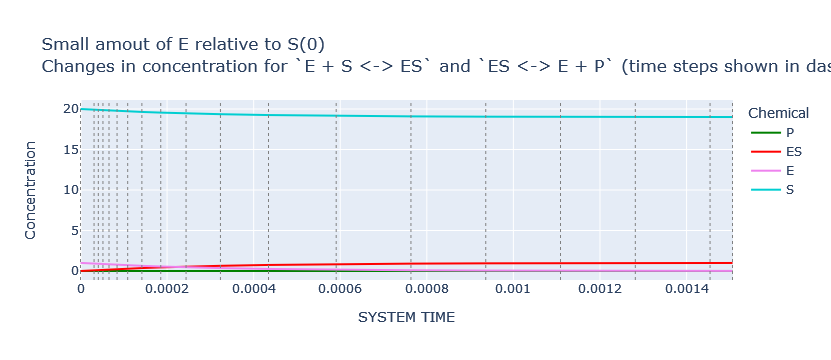

In [15]:
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], show_intervals=True, 
                title_prefix="Small amout of E relative to S(0)")

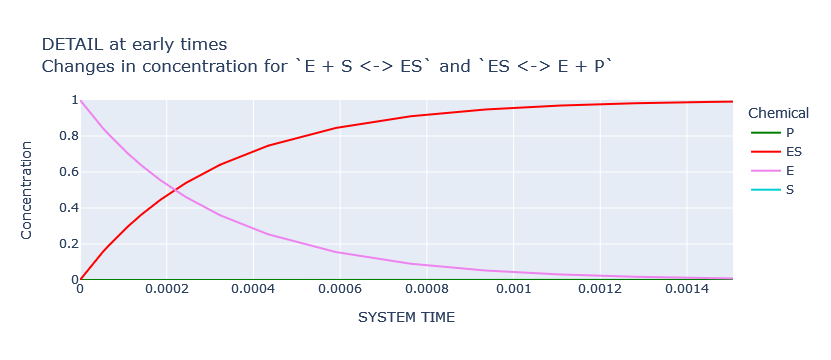

In [16]:
# Highlight a detail about the initial buildup of ES
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], title_prefix="DETAIL at early times",
                range_y=[0, 1])

### Notice the EXTREMELY fast kinetics involving the production of the intermediate `ES`

#### Advance the reactions to equilibrium

In [17]:
# Continue the reactions
uc.single_compartment_react(duration=40., initial_step=0.00001, 
                            snapshots={"frequency": 10})

... running : currently at System Time 17.84 (doing step size 0.00053) after running for 0.5 min
110938 total step(s) taken in 0.64 min
Number of step re-do's because of negative concentrations: 4571
Number of step re-do's because of elective soft aborts: 6
Norm usage: {'norm_A': 110781, 'norm_B': 110800, 'norm_C': 110781, 'norm_D': 110781}
System Time is now: 40.002


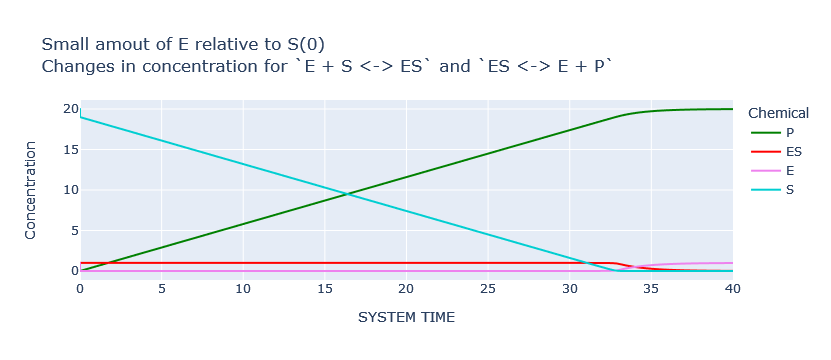

In [18]:
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], 
                title_prefix="Small amout of E relative to S(0)")

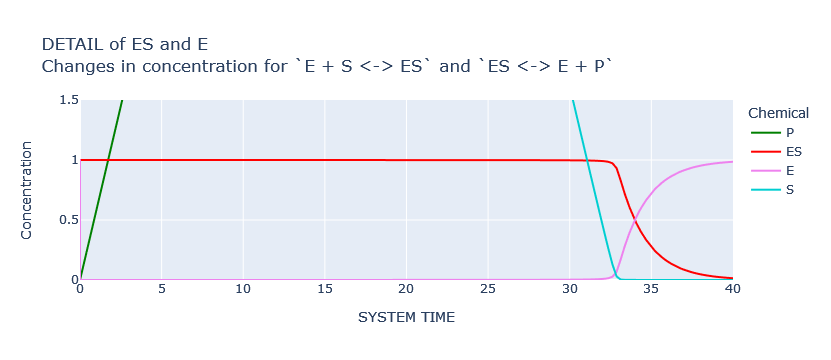

In [19]:
# Highlight a detail about the initial buildup of ES
uc.plot_history(colors=['green', 'red', 'violet', 'darkturquoise'], title_prefix="DETAIL of ES and E",
                range_y=[0, 1.5])

#### Notice how the bound enzyme `ES` (red) quickly builds up at the very beginning, from time 0 to roughly 0.01 ... and that, in the longer term, the enzyme returns to its unbound state `E`

### What is the initial rate of production of the final reaction product `P`?   
One could take the numerical derivative (gradient) of the time values of [P] - but no need to!  **Reaction rates are computed in the course of the simulation, and stored in a rate-history dataframe**

In [20]:
rates = uc.get_rate_history()
rates

,SYSTEM TIME,rxn0_rate,rxn1_rate
0,0.000000,3200.000000,0.000000
1,0.000031,2878.693469,0.055717
2,0.000041,2785.332115,0.072003
3,0.000052,2688.859254,0.088879
4,0.000066,2566.953047,0.110271
...,...,...,...
11107,39.665738,-0.000750,0.010423
11108,39.671328,-0.000294,0.010388
11109,39.685826,-0.000016,0.010300
11110,39.723430,0.000006,0.010077


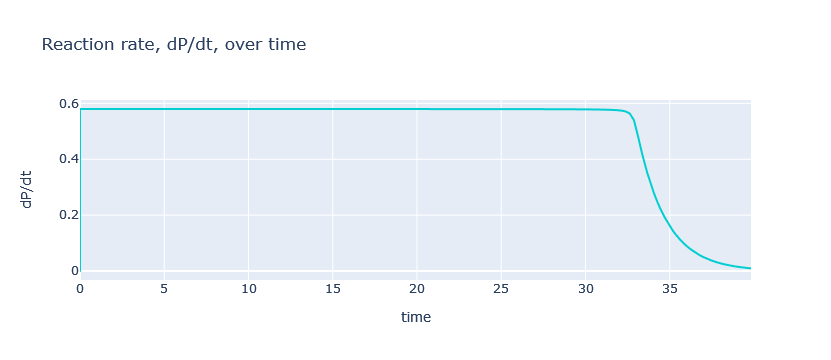

In [21]:
# Let's take a look at how the reaction rate varies with time
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time",
                         x_var="SYSTEM TIME", fields="rxn1_rate", 
                         x_label="time", y_label="dP/dt")

### Notice how very different is it from the Reaction rate over time seen in experiment `enzyme_1_a`

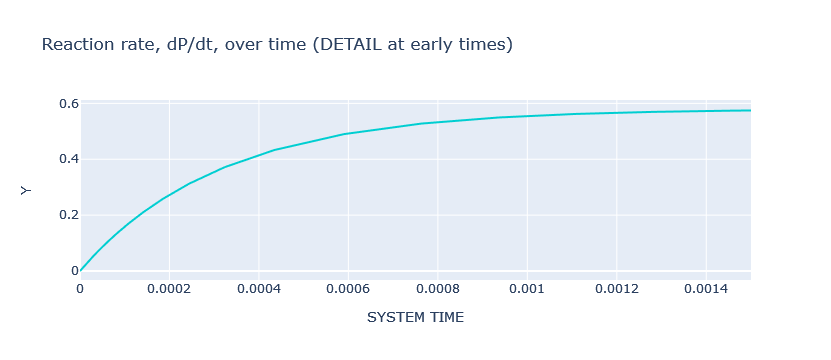

In [22]:
# A closer peek at its very quick buildup
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time (DETAIL at early times)",
                         x_var="SYSTEM TIME", fields="rxn1_rate", 
                         range_x=[0, 0.0015])

As we saw earlier, the time it took for `ES` to build up was about 0.001  
**Ignoring the very brief initial transient phase, the reaction rate starts at about 0.57, and stays at that value until the substrate gets depleted, arount t=33**

# 2. Comparing the results to the Michaelis-Menten model approximation

### Let's compute some parameters used by the Michaelis-Menten model   
for background reference, see:  https://vallance.chem.ox.ac.uk/pdfs/KineticsLectureNotes.pdf (p. 20)

In [23]:
rxn = ReactionEnz(enzyme="E", substrate="S", product="P",
                  k1_F=chem_data.get_forward_rate(0), k1_R=chem_data.get_reverse_rate(0), 
                  k2_F=chem_data.get_forward_rate(1))

In [24]:
rxn.kM          #  For the data in this experiment, it comes out to (0.089 + 0.58) / 160.

0.004181249999999999

In [25]:
rxn.kcat

0.58

In [26]:
vmax = rxn.compute_vmax(E_tot=E0)          # kcat * E0
vmax

0.58

In [27]:
initial_rxn_rate = rxn.compute_rate(S_conc=S0)    #  (vmax * S0) / (kM + S0)
initial_rxn_rate

0.5798787690948362

Pretty close the value of about 0.57 we saw earlier, after the initial transient...   

### Now, let's look at the reaction rate that produces `P` as a function of [S]; we'll compare what we computed earlier vs. what is given by the approximation of the **Michaelis-Menten model**

First, we'll merge the concentration history and and the rate history into a single dataframe `df`

In [28]:
df = uc.add_rate_to_conc_history(rate_name="rxn1_rate", new_rate_name="P_rate")
df

,SYSTEM TIME,P,ES,E,S,caption,P_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,Set concentration,0.000000
1,0.000031,6.703630e-07,0.096064,0.903936,19.903936,,0.055717
2,0.000041,1.294956e-06,0.124144,0.875856,19.875855,,0.072003
3,0.000052,2.140174e-06,0.153239,0.846761,19.846759,,0.088879
4,0.000066,3.520858e-06,0.190123,0.809877,19.809874,,0.110271
...,...,...,...,...,...,...,...
11107,39.665738,1.998202e+01,0.017971,0.982029,0.000005,,0.010423
11108,39.671328,1.998208e+01,0.017910,0.982090,0.000008,,0.010388
11109,39.685826,1.998223e+01,0.017758,0.982242,0.000010,,0.010300
11110,39.723430,1.998262e+01,0.017375,0.982625,0.000010,,0.010077


In [29]:
# Let's add a column with the rate estimated by the Michaelis-Menten model
df["Michaelis_rate"] = rxn.compute_rate(S_conc=df["S"])
df

,SYSTEM TIME,P,ES,E,S,caption,P_rate,Michaelis_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,Set concentration,0.000000,0.579879
1,0.000031,6.703630e-07,0.096064,0.903936,19.903936,,0.055717,0.579878
2,0.000041,1.294956e-06,0.124144,0.875856,19.875855,,0.072003,0.579878
3,0.000052,2.140174e-06,0.153239,0.846761,19.846759,,0.088879,0.579878
4,0.000066,3.520858e-06,0.190123,0.809877,19.809874,,0.110271,0.579878
...,...,...,...,...,...,...,...,...
11107,39.665738,1.998202e+01,0.017971,0.982029,0.000005,,0.010423,0.000749
11108,39.671328,1.998208e+01,0.017910,0.982090,0.000008,,0.010388,0.001145
11109,39.685826,1.998223e+01,0.017758,0.982242,0.000010,,0.010300,0.001378
11110,39.723430,1.998262e+01,0.017375,0.982625,0.000010,,0.010077,0.001366


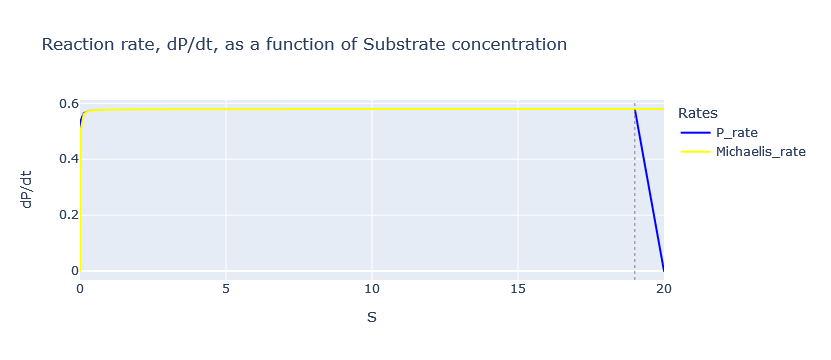

In [30]:
# Let's see how our computed rate compares with the approximations from the Michaelis-Menten model
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19, colors=["blue", "yellow"])

Let's recall that our reactions started with [S]=20  
Virtually overlapped plots, except at the very right! (very early times, when [S] is greater than about 19)

The overlap at the very left (small [S], late in the reaction) has a few issues, but not too bad; let's magnify the previous plot:

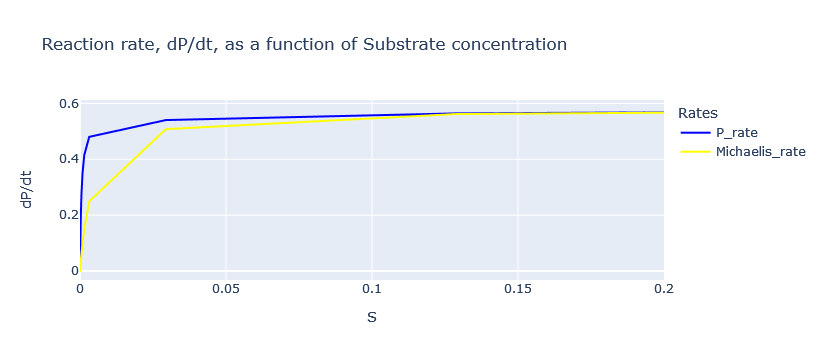

In [31]:
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19, colors=["blue", "yellow"],
                         range_x=[0, .2])

## In this scenario, the Michaelis-Menten model is remarkable accurate EXCEPT at the very early times of the reaction (the large values of `S`), which is the brief initial transient phase when `ES` builds up from zero.  
### Some discrepancy also at the end of the reaction (when `S` drops to zero)

#### This is as expected, because the kinetic parameters of this reaction satisfy the key Michaelis-Menten assumptions that `[E] << [S]` , but NOT the other assumption that the rates satisfy `k1_reverse >> k2_forward`

# 3. Comparing the results to the Morrison model

#### Following section 7.1 of _"Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023_, we'll test out an the alternative **Morrison** approach, which is expected to perform better than the **Michaelis-Menten** model when the Enzyme concentration isn't so small.  But, in this scenario, we only have small amounts of enzyme - and we'll see below that no significant improvement is gained by switching model.

In [32]:
df["Morrison_rate"] = rxn.compute_rate_morrison(E_tot=E0,
                                                S_tot=df["S"] + df["ES"])
df

,SYSTEM TIME,P,ES,E,S,caption,P_rate,Michaelis_rate,Morrison_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,Set concentration,0.000000,0.579879,0.579872
1,0.000031,6.703630e-07,0.096064,0.903936,19.903936,,0.055717,0.579878,0.579872
2,0.000041,1.294956e-06,0.124144,0.875856,19.875855,,0.072003,0.579878,0.579872
3,0.000052,2.140174e-06,0.153239,0.846761,19.846759,,0.088879,0.579878,0.579872
4,0.000066,3.520858e-06,0.190123,0.809877,19.809874,,0.110271,0.579878,0.579872
...,...,...,...,...,...,...,...,...,...
11107,39.665738,1.998202e+01,0.017971,0.982029,0.000005,,0.010423,0.000749,0.010382
11108,39.671328,1.998208e+01,0.017910,0.982090,0.000008,,0.010388,0.001145,0.010349
11109,39.685826,1.998223e+01,0.017758,0.982242,0.000010,,0.010300,0.001378,0.010262
11110,39.723430,1.998262e+01,0.017375,0.982625,0.000010,,0.010077,0.001366,0.010040


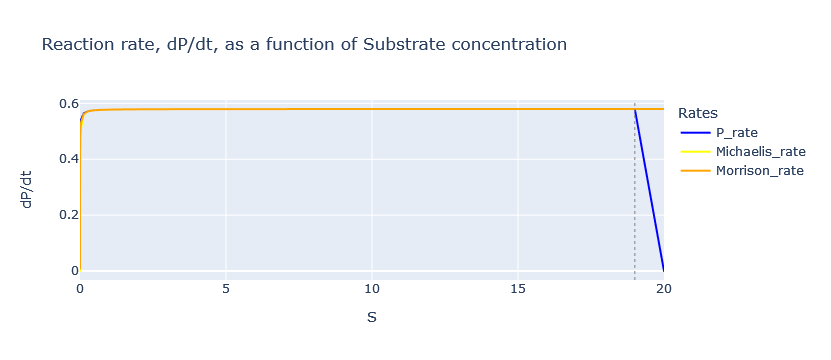

In [33]:
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate", "Morrison_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19,
                         colors=["blue", "yellow", "orange"])

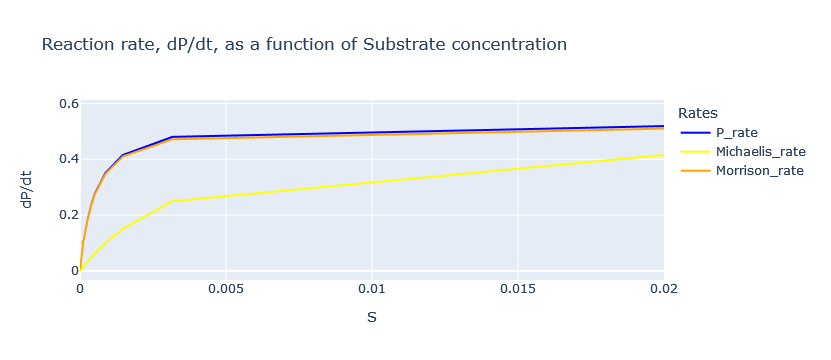

In [34]:
# Detail at the very left
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate", "Morrison_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19,
                         colors=["blue", "yellow", "orange"],
                         range_x=[0, 0.02])

# In this scenario, the Morrison model appears better than the Michaelis-Menten one at late reaction times (small `S`, close to zero) - and virtually identical elsewhere 